In [1]:
import marimo as mo
import sys
from pathlib import Path

# Setup path para imports
project_root = Path.cwd()
if project_root.name != 'KmeansV3':
    # Si estamos en un directorio diferente, buscar KmeansV3
    if (project_root / 'KmeansV3').exists():
        project_root = project_root / 'KmeansV3'

sys.path.insert(0, str(project_root))

from src.kmeans import KMeans, KMeansConfig, process_images_batch
from src.viz import load_and_display_bsd_images, plot_kmeans_results, plot_levelset_results, plot_cluster_distances_grid, plot_evolution_results, plot_segmentation_comparison_batch
from src.data_loader import DataLoader
from src.level_set import LevelSet, LevelSetConfig, process_levelsets_batch, process_evolution_batch, extract_evolved_labels_batch
from src.pri import TruePRIEvaluator, PRIConfig, PRICacheManager

# Customized K-Means Clustering Based Color Image Segmentation Measuring PRI

Este notebook presenta un análisis de segmentación de imágenes usando K-Means clustering
con evaluación mediante el **Probabilistic Rand Index (PRI)**.

Trabajaremos con tres imágenes del dataset **BSD500** para demostrar la efectividad del método
de segmentación propuesto.

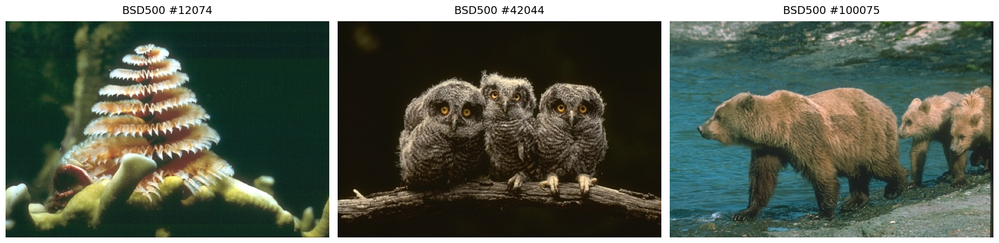

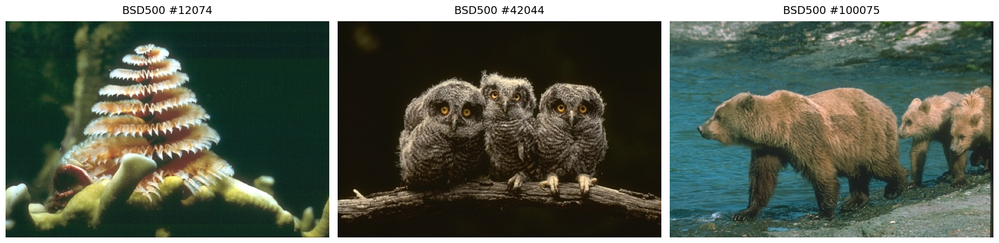

In [2]:
# Crear instancia de DataLoader
loader = DataLoader()

# Cargar las 3 imágenes usando DataLoader
bsd_images = loader.load_all_images()

# Visualizar usando función de viz (pasando imágenes pre-cargadas)
fig_grid, _ = load_and_display_bsd_images(images=bsd_images)
fig_grid

## Imágenes Seleccionadas del Dataset BSD500

**Imagen 12074**: Imagen de referencia del paper original. Contiene múltiples regiones
con diferentes texturas y colores, ideal para evaluar la capacidad del algoritmo
de separar correctamente áreas homogéneas.

**Imagen 42044**: Caso de prueba con múltiples regiones claramente diferenciadas.
Presenta un desafío interesante para el algoritmo debido a la variabilidad de colores
y la complejidad de los bordes.

**Imagen 100075**: Ejemplo con contornos complejos y transiciones suaves entre regiones.
Útil para evaluar la robustez del algoritmo en escenarios con bordes difusos.

---

Estas imágenes serán utilizadas para evaluar el rendimiento del algoritmo de K-Means
customizado y medir la calidad de segmentación mediante el **índice PRI** (Probabilistic Rand Index).

El PRI permite comparar la segmentación automática generada por K-Means con las
segmentaciones manuales (ground truth) realizadas por múltiples anotadores humanos.

## Aplicación de K-Means Clustering

A continuación aplicaremos el algoritmo de K-Means a cada imagen usando los parámetros
óptimos encontrados en experimentos previos.

Para cada imagen se muestra:
- **Columna 1**: Imagen original del dataset BSD500
- **Columna 2**: Imagen clusterizada con K colores dominantes (posterización)
- **Columna 3**: Distribución de colores dominantes con sus frecuencias

El número de clusters (K) se obtiene automáticamente de los resultados guardados
que produjeron los mejores valores de PRI en experimentos anteriores.

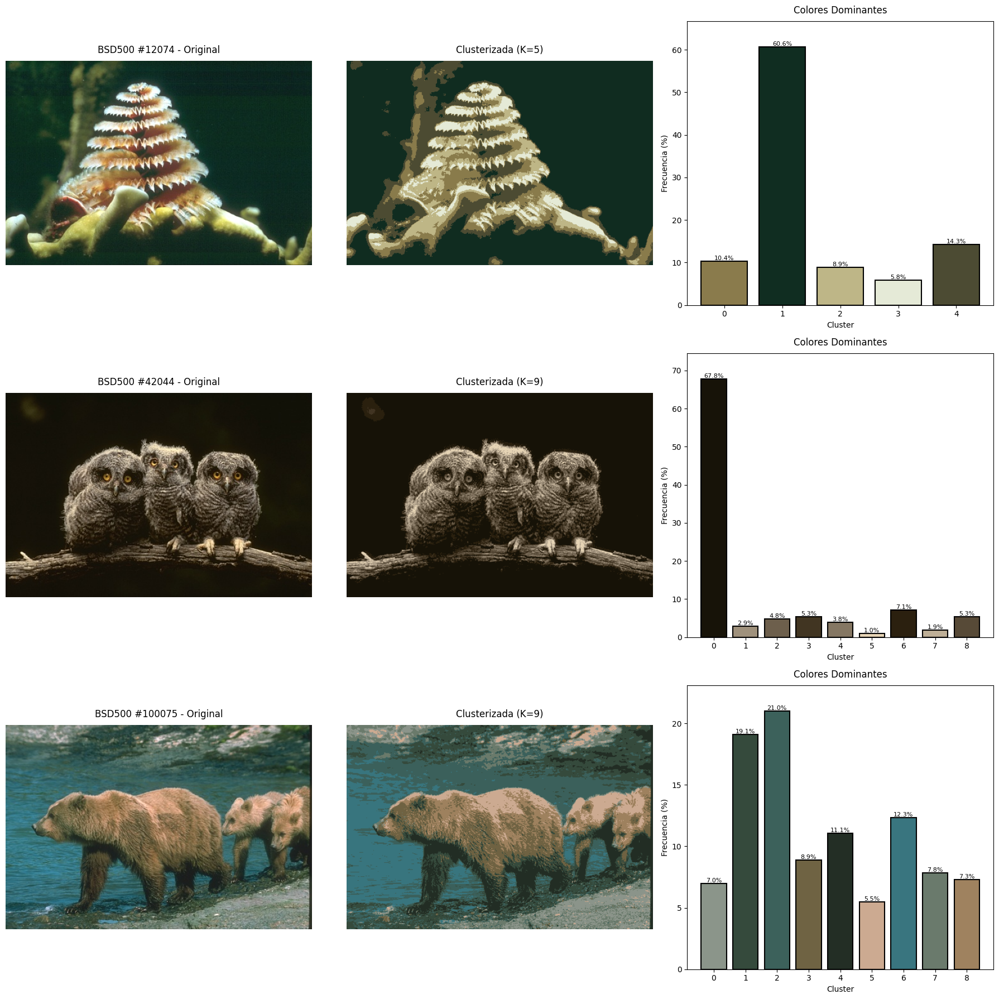

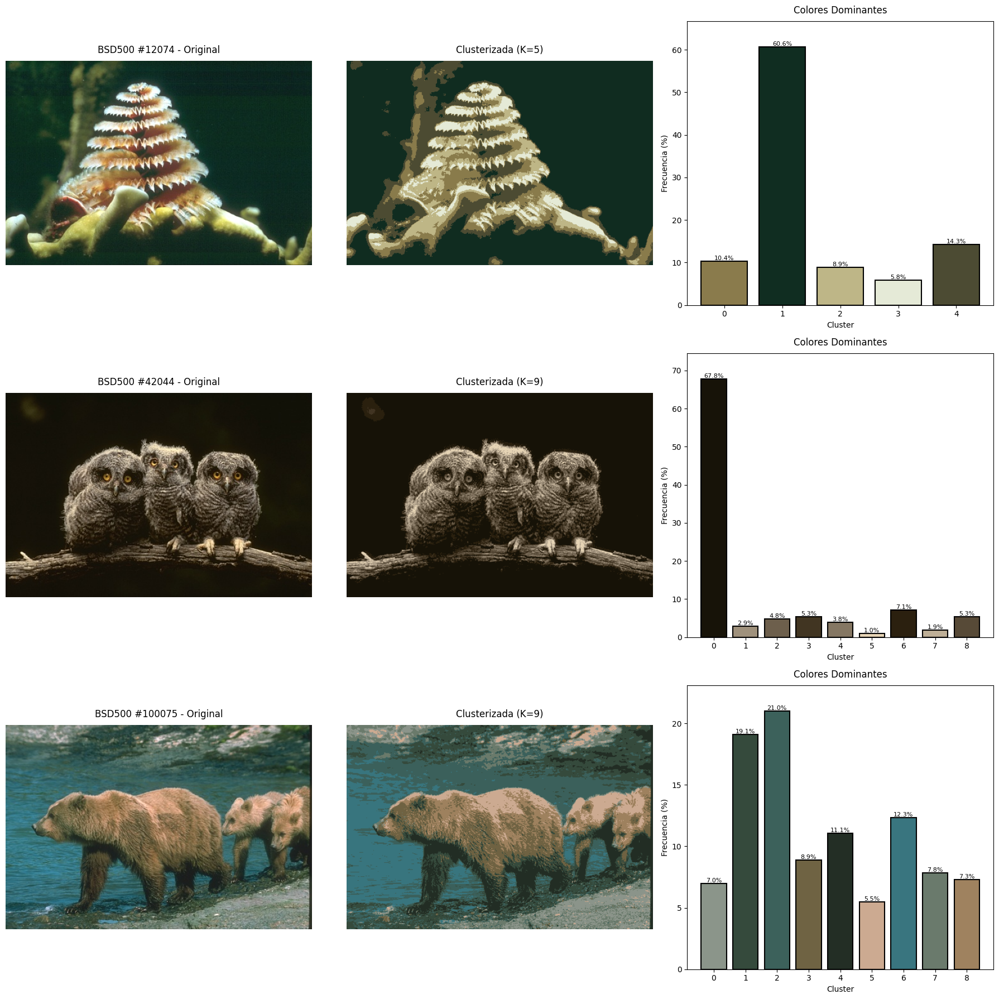

In [3]:
# Cargar los snapshots con los mejores parámetros para cada imagen
image_ids_list = list(bsd_images.keys())
snapshots = {img_id: loader.load_result(img_id) for img_id in image_ids_list}

# Aplicar K-Means a cada imagen usando los parámetros guardados
kmeans_results = process_images_batch(bsd_images, snapshots)

# Visualizar resultados en grid 3x3
fig_kmeans = plot_kmeans_results(bsd_images, kmeans_results)
fig_kmeans

## Transformación a Signed Distance Function

A continuación transformamos los resultados de K-Means clustering a **funciones de distancia firmada** (Signed Distance Functions - SDF) utilizando el método de Fast Marching.

La SDF representa para cada píxel su distancia al borde del cluster más cercano, creando una representación continua de los límites entre regiones. Esta transformación es fundamental para:
- **Level Set Evolution**: Permite evolucionar los contornos usando ecuaciones diferenciales
- **Suavizado de fronteras**: Facilita el refinamiento de bordes mediante flujo de curvatura
- **Detección de bordes**: Los valores cercanos a cero indican la ubicación precisa de los límites entre clusters

Para cada imagen se muestra:
- **Columna 1**: Segmentación K-Means con K colores dominantes
- **Columna 2**: Mapa de distancia firmada (SDF)
  - Valores positivos (rojos): Interior de los clusters
  - Valores cercanos a cero: Fronteras entre clusters
  - El colormap muestra la transición continua desde los centros de cluster hacia sus bordes

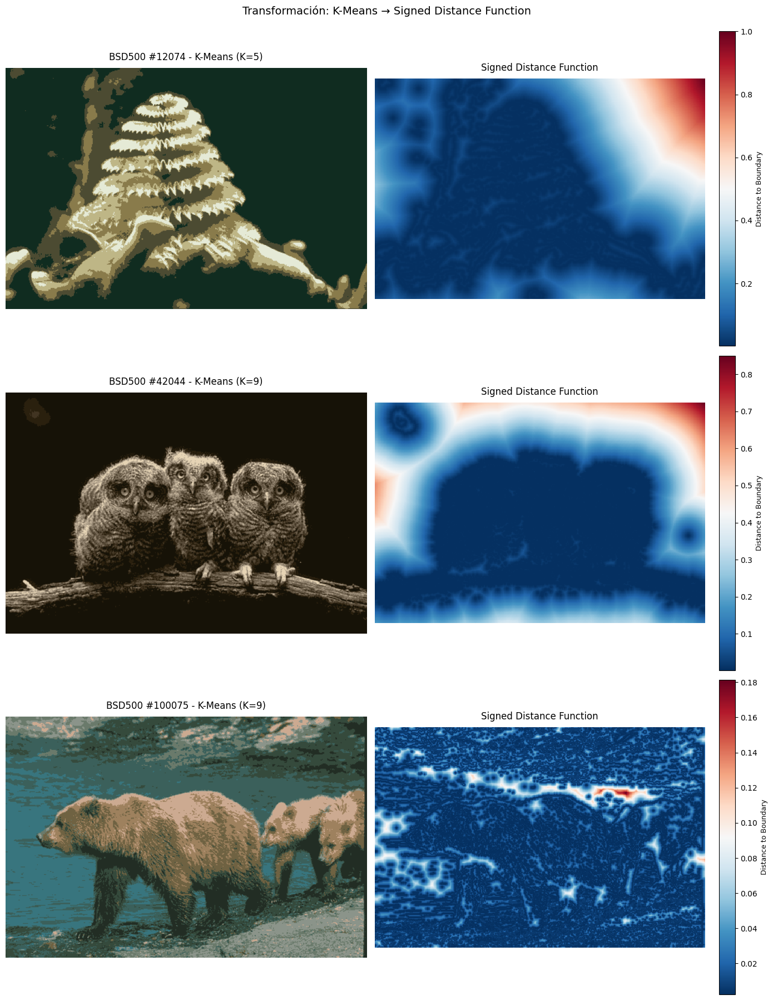

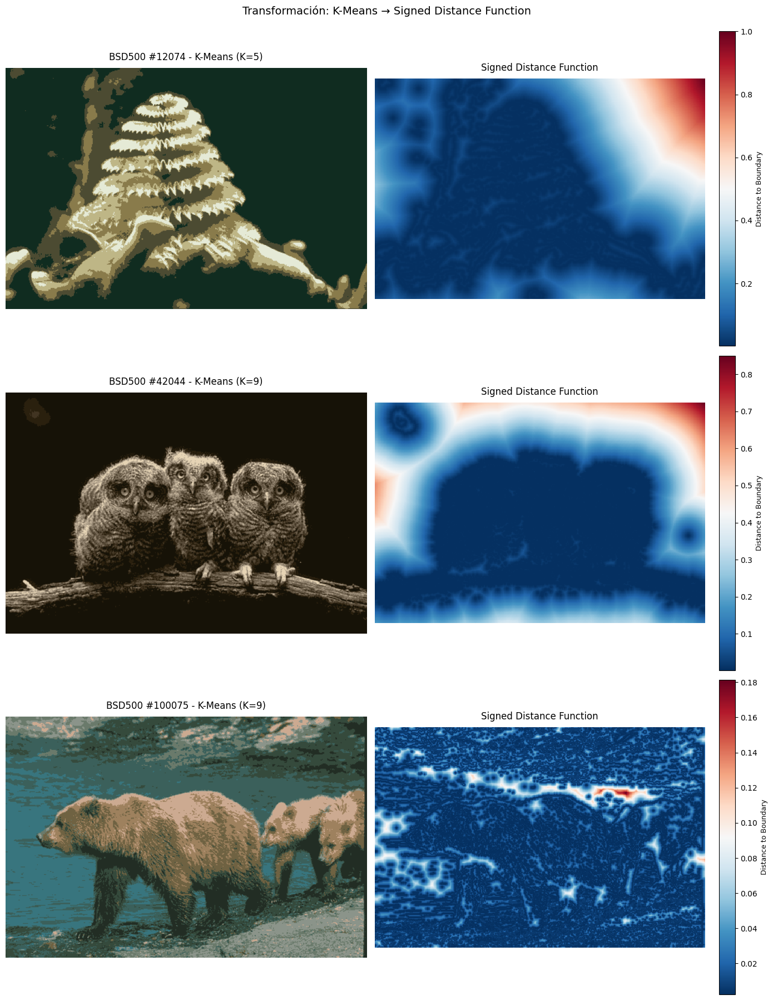

In [4]:
# Configurar Level Set con normalización
levelset_config = LevelSetConfig(
    normalize=True
)

# Transformar resultados de K-Means a Level Sets (SDF)
levelset_results = process_levelsets_batch(kmeans_results, bsd_images, levelset_config)

# Visualizar transformación en grid 3x2
fig_levelset = plot_levelset_results(bsd_images, kmeans_results, levelset_results)
fig_levelset

## Análisis Por Cluster - Signed Distance Functions

A continuación se muestran los **Signed Distance Functions individuales** para cada cluster
de cada imagen procesada. Esta visualización permite analizar en detalle cómo se distribuye
la distancia firmada dentro de cada región segmentada.

Para cada imagen se presenta un grid con todos sus clusters. Cada subplot muestra:
- **Heatmap del SDF**: Colormap divergente RdBu_r centrado en cero
  - **Rojo (valores negativos)**: Píxeles dentro del cluster
  - **Azul (valores positivos)**: Píxeles fuera del cluster
  - **Blanco (cero)**: Frontera exacta del cluster
- **Contorno amarillo**: Marca la curva φ=0, el borde preciso del cluster

Esta representación es fundamental para:
- Entender la geometría interna de cada cluster
- Identificar qué tan "compactos" o "dispersos" son los clusters
- Visualizar la suavidad de las fronteras entre regiones
- Preparar el terreno para evolución de level sets (refinamiento de bordes)

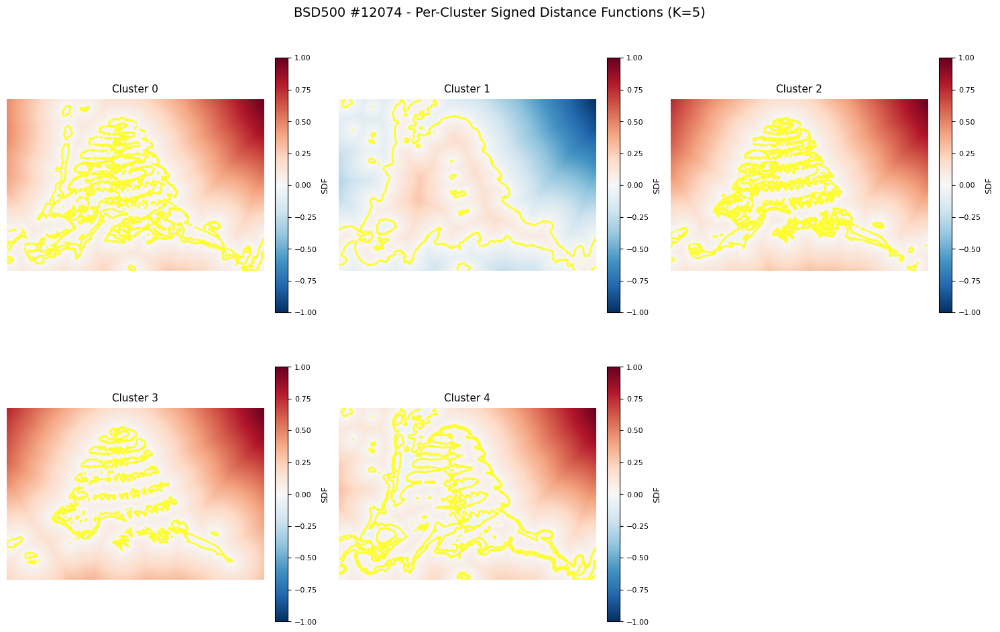

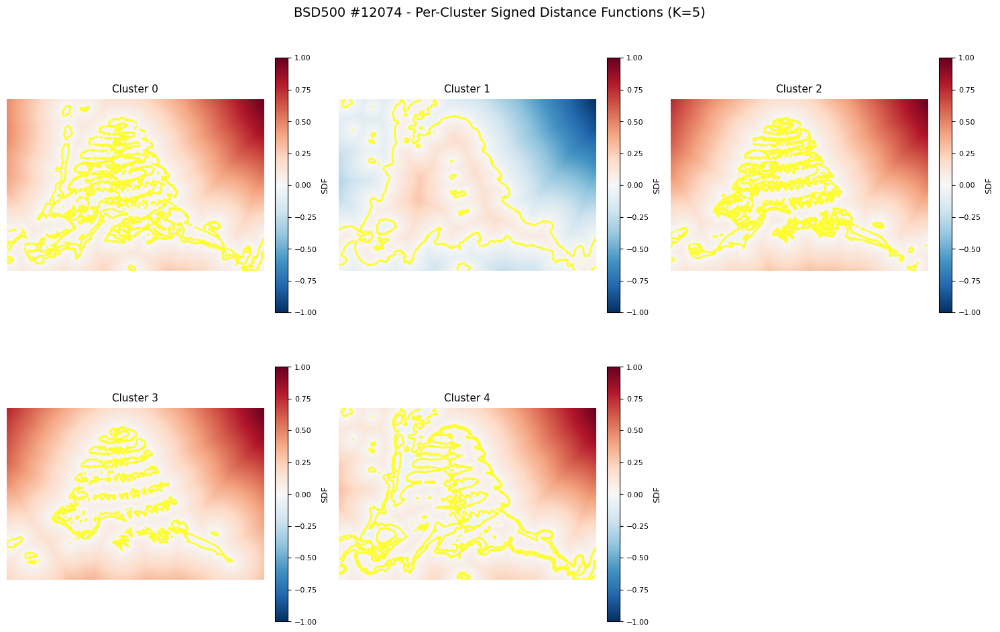

In [5]:
# Imagen 12074 - Per-Cluster SDFs
mo.md("### Imagen 12074 - SDFs por Cluster")

fig_clusters_12074 = plot_cluster_distances_grid(
    '12074',
    kmeans_results['12074'],
    levelset_results['12074'],
    bsd_images['12074']
)
fig_clusters_12074

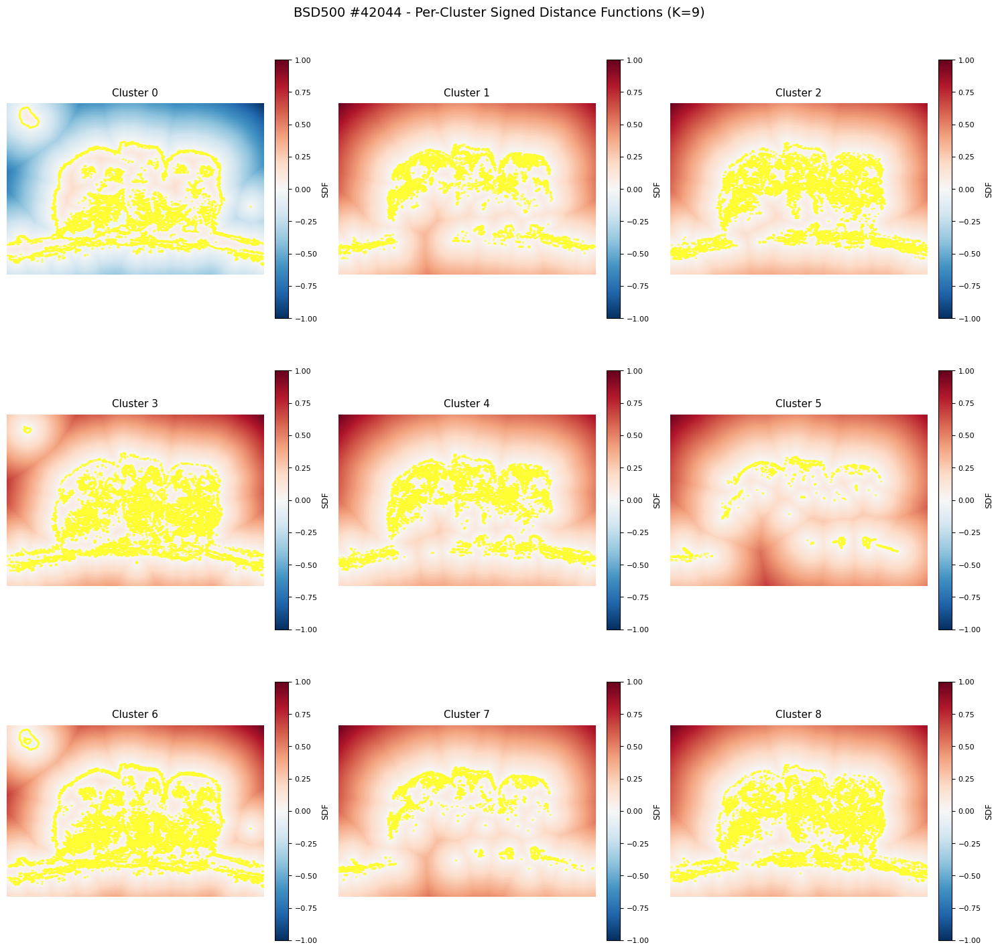

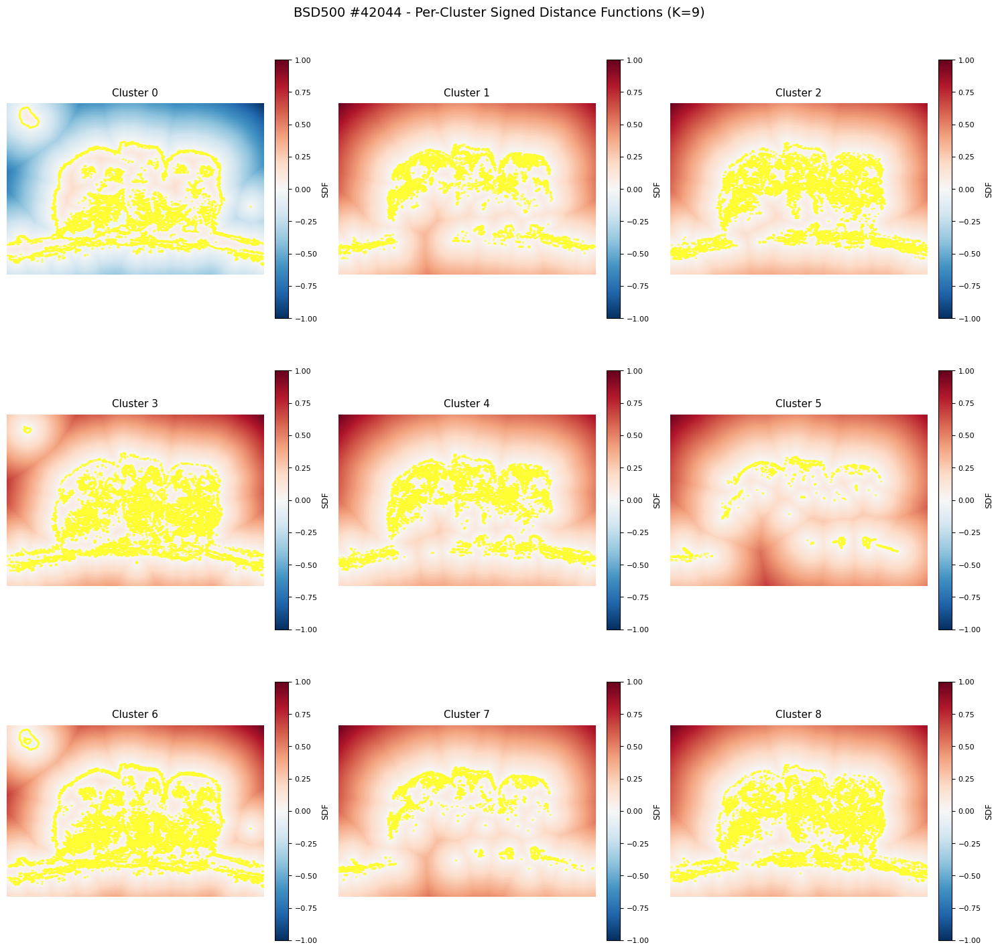

In [6]:
# Imagen 42044 - Per-Cluster SDFs
mo.md("### Imagen 42044 - SDFs por Cluster")

fig_clusters_42044 = plot_cluster_distances_grid(
    '42044',
    kmeans_results['42044'],
    levelset_results['42044'],
    bsd_images['42044']
)
fig_clusters_42044

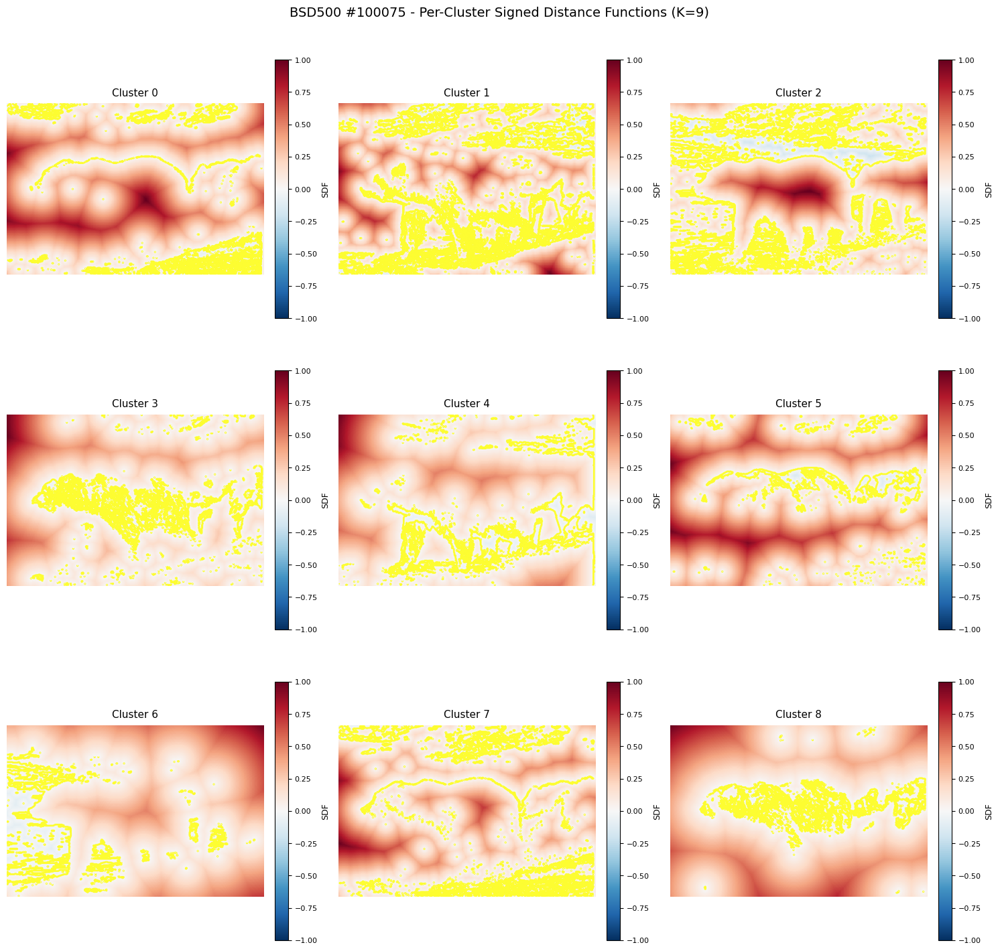

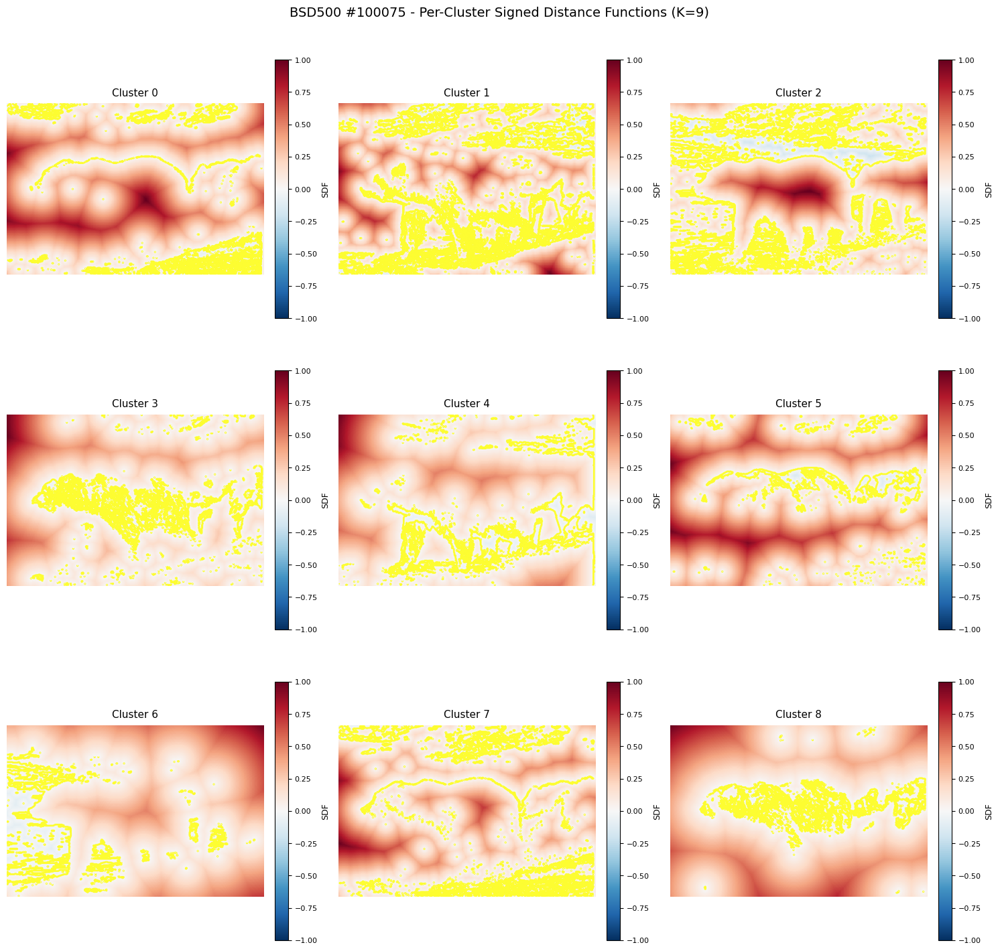

In [7]:
# Imagen 100075 - Per-Cluster SDFs
mo.md("### Imagen 100075 - SDFs por Cluster")

fig_clusters_100075 = plot_cluster_distances_grid(
    '100075',
    kmeans_results['100075'],
    levelset_results['100075'],
    bsd_images['100075']
)
fig_clusters_100075

## Velocity Field Computation y Level Set Evolution

A continuación aplicaremos **velocity field computation** y **level set evolution** para refinar
las fronteras de los clusters obtenidos con K-Means.

**Método Implementado: Curvature con Edge-Stopping (Scikit-Image)**

Este método utiliza **mean curvature flow** con edge-stopping basado en
`inverse_gaussian_gradient` de scikit-image, que es el método probado usado en
morphological geodesic active contours (MorphGAC).

**¿Cómo funciona?**

1. **Edge-stopping function**: Se calcula un mapa de bordes donde:
   - Regiones planas → valores cercanos a 1 (alta velocidad, la frontera se suaviza)
   - Bordes fuertes → valores cercanos a 0 (baja velocidad, la frontera se detiene)

2. **Curvature velocity**: Para cada cluster, se calcula:
   - κ (curvature) = div(∇φ/|∇φ|)
   - velocity = smoothing × κ × edge_function

3. **Evolution**: Se aplica iterativamente la ecuación:
   - dφ/dt = velocity
   - Discretizada: φ_new = φ_old + dt × velocity

4. **Re-initialization**: Cada N iteraciones se re-inicializa φ usando Fast Marching Method
   para mantener estabilidad numérica.

**Parámetros:**

Los parámetros de evolución se extraen automáticamente del **snapshot JSON** para cada imagen,
asegurando que se usen los mejores valores encontrados en experimentos previos:

- **alpha**: Steepness of edge inversion (del JSON)
- **sigma**: Gaussian blur (del JSON)
- **smoothing**: Curvature flow strength (del JSON)
- **dt**: Time step (del JSON)
- **n_iterations**: Número de iteraciones (del JSON)
- **reinit_freq**: Re-initialize frequency (del JSON)

Por ejemplo, para imagen 12074: alpha=100.0, sigma=5.0, smoothing=0.01, dt=0.01

In [8]:
# Aplicar velocity computation y evolution a todas las imágenes
# Usa parámetros del snapshot (JSON) para obtener los mejores resultados
evolved_results = process_evolution_batch(
    levelset_results,
    bsd_images,
    snapshots=snapshots  # ← Parámetros extraídos automáticamente del JSON
)

---

## Evolution Results: Fronteras Evolucionadas

A continuación se muestran las **fronteras evolucionadas** para cada cluster de cada imagen.

Para cada imagen se presenta un grid con K subplots (uno por cluster). Cada subplot muestra:
- **Imagen original** como fondo
- **Contorno amarillo** en φ=0 indicando la frontera evolucionada del cluster

Las fronteras han sido refinadas mediante:
- **Suavizado de curvas**: Eliminación de esquinas agudas y bordes irregulares
- **Edge-stopping**: Las fronteras se detienen en bordes fuertes de la imagen
- **Preservación de topología**: La re-inicialización mantiene la forma general

Compara estas fronteras con las SDFs iniciales (sección anterior) para observar
cómo el flujo de curvatura ha suavizado las fronteras mientras respeta los bordes naturales
de la imagen.

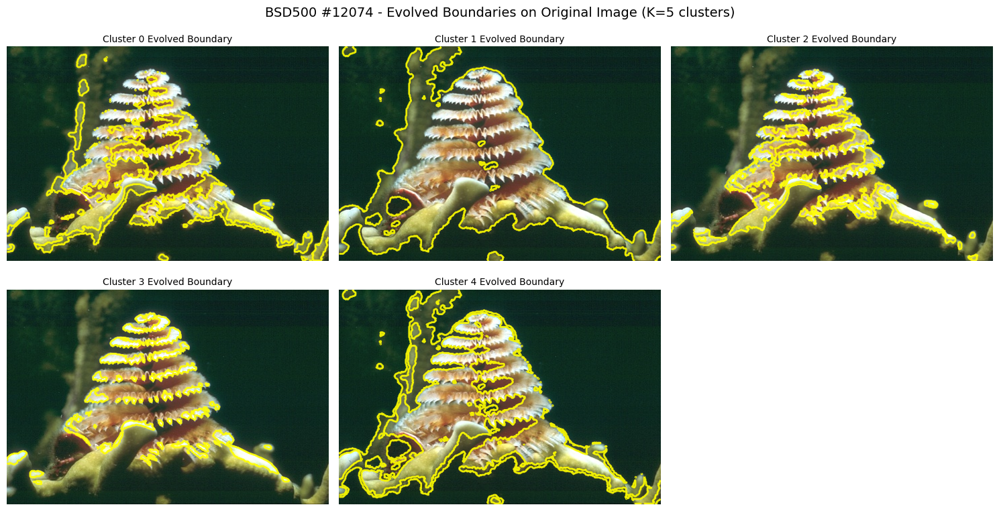

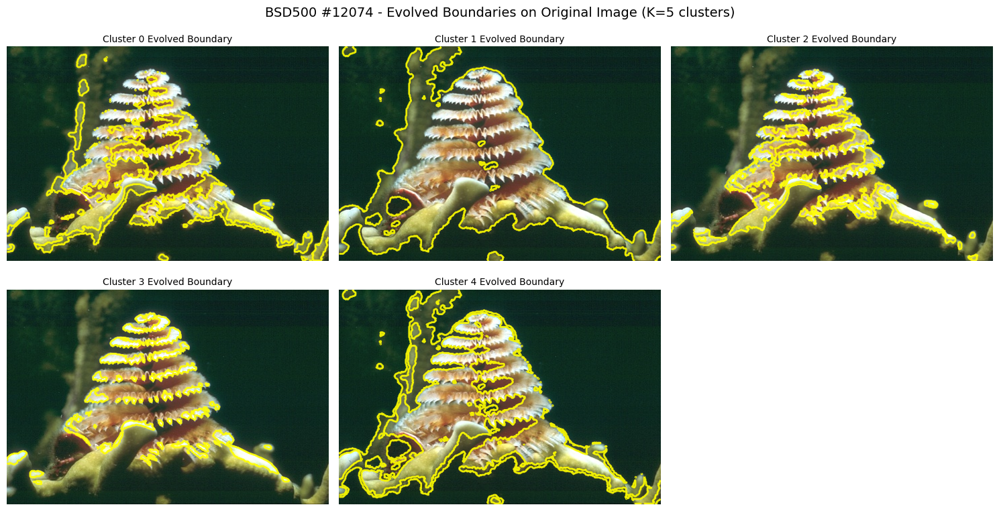

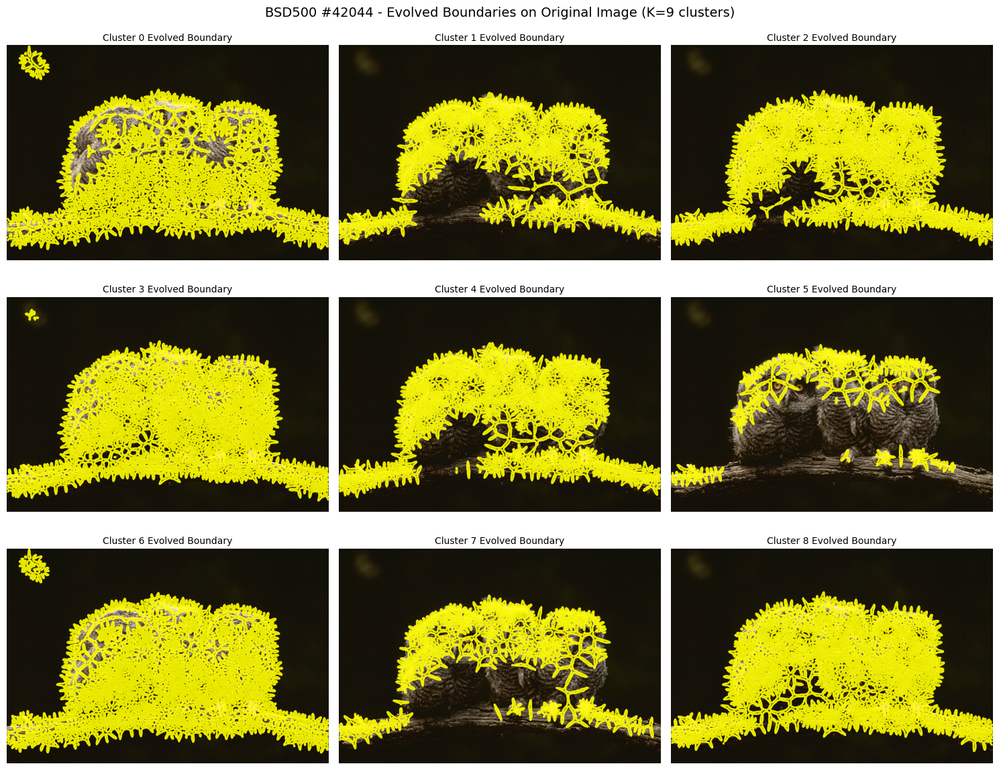

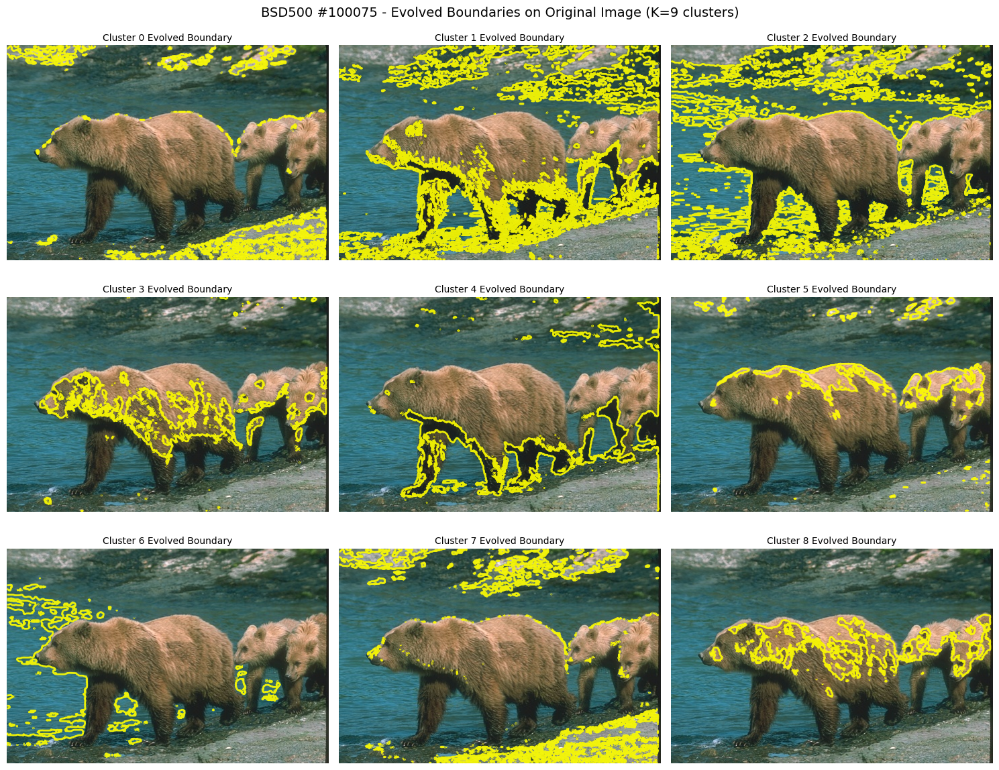

In [9]:
# Visualizar evolution results para todas las imágenes
mo.md("### Evolved Boundaries - Todas las Imágenes")

# Obtener figuras para las 3 imágenes
evolution_figs = plot_evolution_results(bsd_images, evolved_results, kmeans_results)

# Mostrar figura de imagen 12074
mo.md("#### BSD500 #12074 - Evolved Boundaries")
fig_evolution_12074 = evolution_figs['12074']
fig_evolution_12074  # ← Mostrar la figura

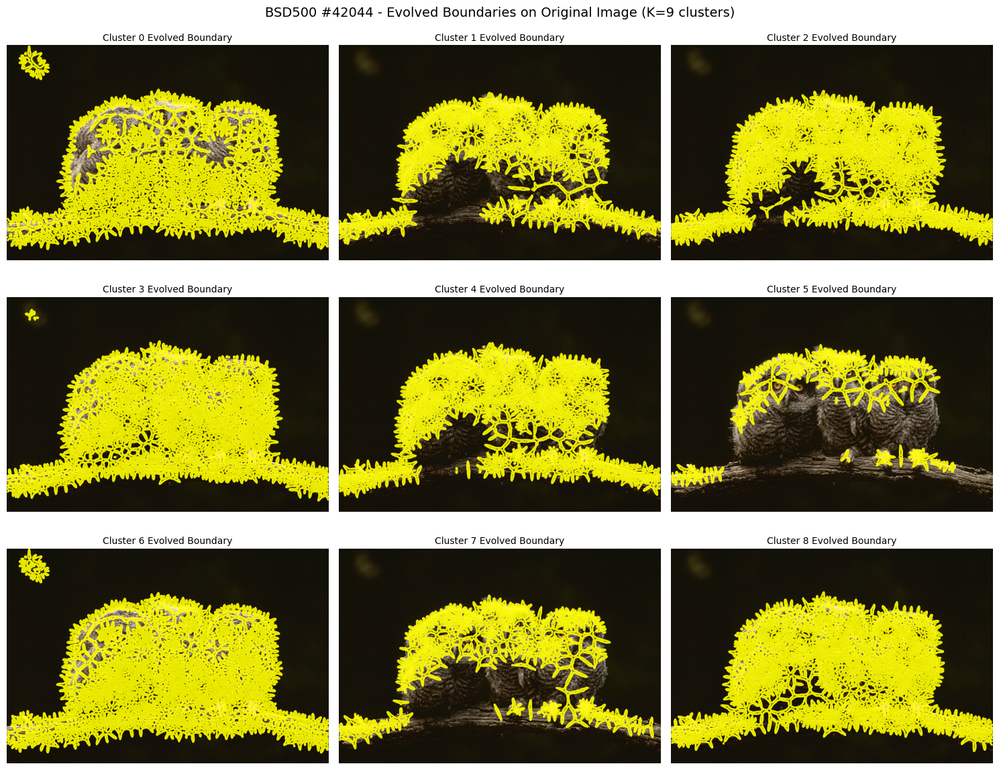

In [10]:
# Mostrar figura de imagen 42044
mo.md("#### BSD500 #42044 - Evolved Boundaries")
fig_evolution_42044 = evolution_figs['42044']
fig_evolution_42044

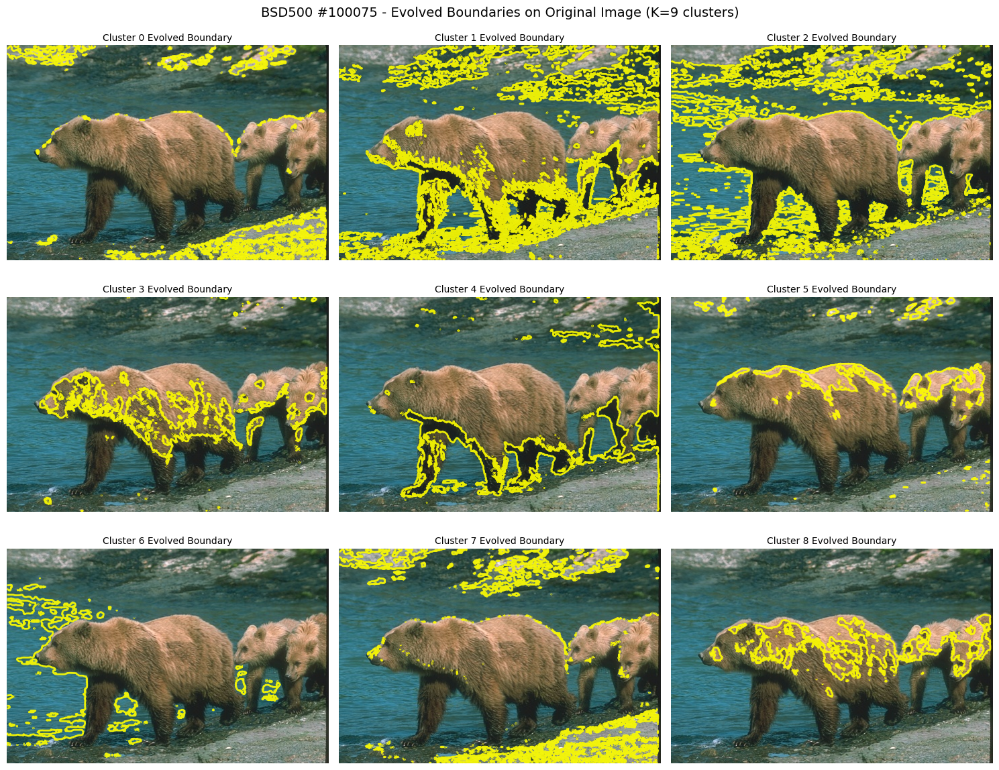

In [11]:
# Mostrar figura de imagen 100075
mo.md("#### BSD500 #100075 - Evolved Boundaries")
fig_evolution_100075 = evolution_figs['100075']
fig_evolution_100075

---

## Comparación de Segmentación: K-Means vs Evolved

A continuación presentamos una **comparación visual directa** entre la segmentación inicial obtenida con K-Means y la segmentación final después de la evolución de level sets.

Esta visualización permite observar cómo la evolución refina las fronteras de los clusters:

- **Columna 1: Imagen Original** - Input del pipeline de segmentación
- **Columna 2: K-Means Segmentation** - Asignación inicial de clusters basada en colores dominantes
- **Columna 3: Evolved Segmentation** - Asignación final después de aplicar level set evolution

**¿Qué cambia con la evolución?**

- **Suavizado de fronteras**: Las fronteras irregulares se vuelven más suaves y coherentes
- **Edge-stopping**: Las fronteras se ajustan para detenerse en bordes fuertes de la imagen
- **Preservación de topología**: La estructura general de los clusters se mantiene
- **Refinamiento local**: Pequeños ajustes en píxeles cercanos a las fronteras

Los colores asignados a cada cluster son consistentes entre ambas segmentaciones, permitiendo identificar fácilmente qué regiones cambiaron después de la evolución.

In [12]:
# Extraer labels de segmentación de los level sets evolucionados
# Usa winner-takes-all: cada píxel se asigna al cluster con φ más negativo
evolved_labels = extract_evolved_labels_batch(levelset_results)

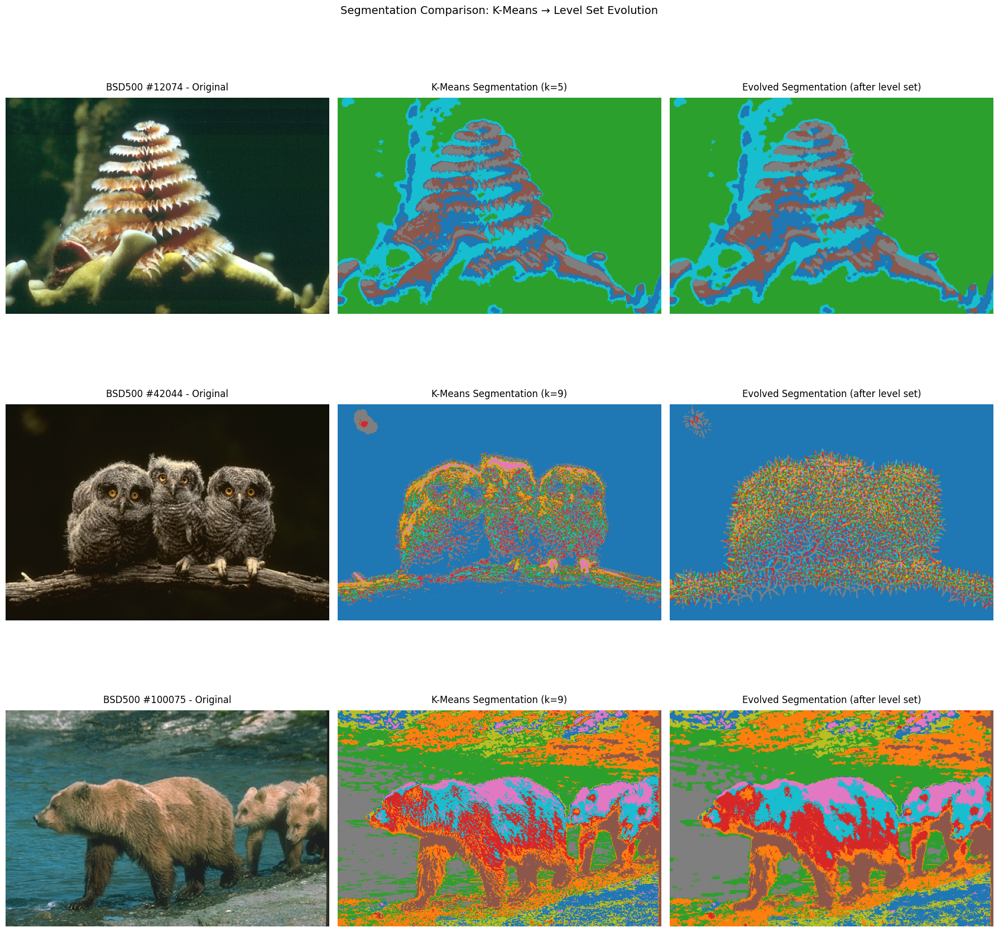

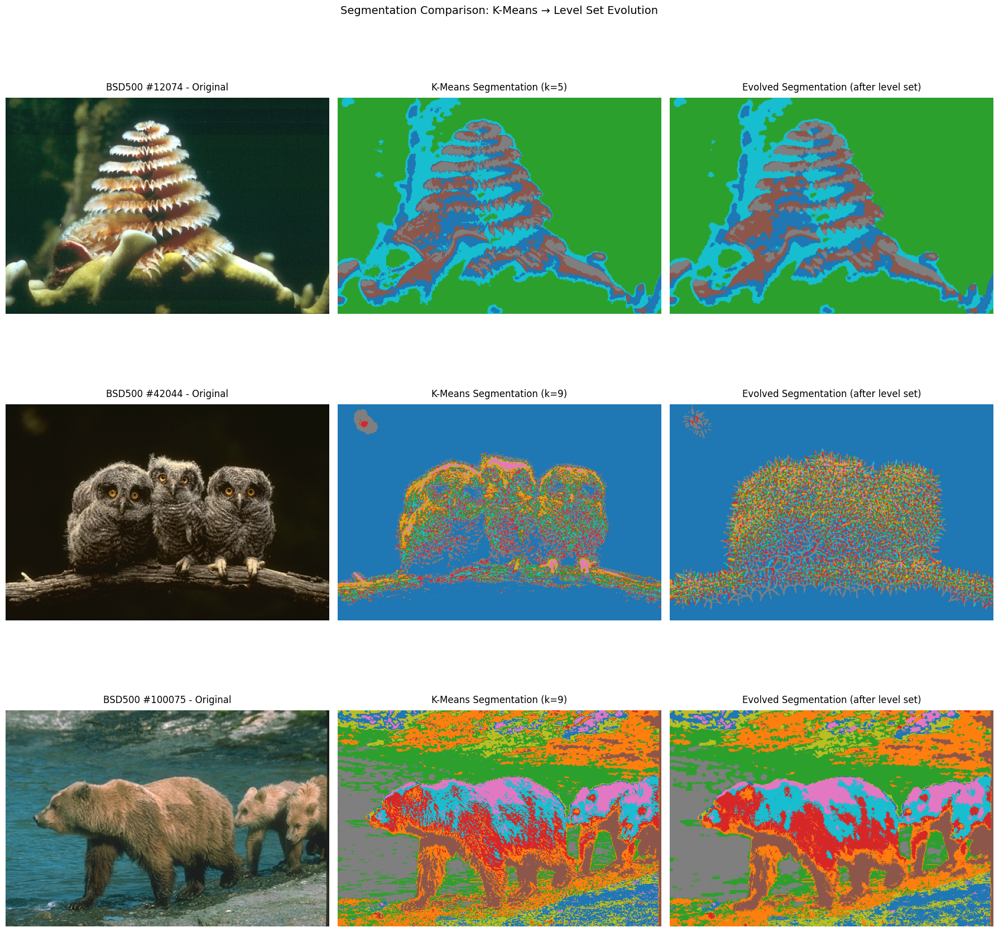

In [13]:
# Visualizar comparación de segmentación en grid 3x3
# 3 filas (una por imagen) × 3 columnas (Original | K-Means | Evolved)
fig_segmentation_comparison = plot_segmentation_comparison_batch(
    original_images=bsd_images,
    kmeans_results=kmeans_results,
    evolved_labels_dict=evolved_labels
)
fig_segmentation_comparison

---

## Probabilistic Rand Index (PRI)

El **Probabilistic Rand Index (PRI)** es una métrica cuantitativa para evaluar la calidad de la segmentación comparándola con múltiples anotaciones humanas (ground truth).

### Fórmula del PRI

$$
PRI(S, \{G_k\}) = \frac{1}{T} \sum_{i,m} \left[ c_{im} \cdot p_{im} + (1 - c_{im}) \cdot (1 - p_{im}) \right]
$$

**Donde:**
- **S** = Segmentación automatizada (resultado de K-Means o Evolved)
- **{Gₖ}** = Conjunto de ground truths (5 anotaciones humanas del BSD500)
- **c_im** = 1 si los píxeles i y m tienen la misma etiqueta en S, 0 en caso contrario
- **p_im** = Probabilidad de que i y m tengan la misma etiqueta según los ground truths
- **T** = Número total de pares de píxeles muestreados (10,000)

In [14]:
# Configurar PRI evaluator con caché
pri_cache_path = loader.get_pri_cache_path()
pri_config = PRIConfig(
    n_samples=10000,
    use_cache=True,
    cache_path=pri_cache_path
)

pri_cache_mgr = PRICacheManager(pri_config.cache_path)
pri_evaluator = TruePRIEvaluator(pri_config, pri_cache_mgr)

# Calcular PRI para todas las imágenes
pri_results = {}
ground_truths_dict = {}

for img_id in image_ids_list:
    # Cargar ground truths (5 anotaciones humanas)
    ground_truths = loader.load_ground_truths(img_id)
    ground_truths_dict[img_id] = ground_truths

    # Obtener labels de K-Means (reshape a H,W si es necesario)
    kmeans_labels = kmeans_results[img_id].labels
    h, w = bsd_images[img_id].shape[:2]
    if kmeans_labels.ndim == 1:
        kmeans_labels = kmeans_labels.reshape(h, w)

    # Obtener labels evolucionados
    evolved_labels_img = evolved_labels[img_id]
    if evolved_labels_img.ndim == 1:
        evolved_labels_img = evolved_labels_img.reshape(h, w)

    # Calcular PRI para K-Means
    pri_kmeans = pri_evaluator.evaluate(img_id, kmeans_labels, ground_truths)

    # Calcular PRI para Evolved
    pri_evolved = pri_evaluator.evaluate(img_id, evolved_labels_img, ground_truths)

    # Calcular mejora
    pri_improvement = pri_evolved - pri_kmeans
    pri_improvement_pct = (pri_improvement / pri_kmeans) * 100 if pri_kmeans > 0 else 0

    # Guardar resultados
    pri_results[img_id] = {
        'pri_kmeans': pri_kmeans,
        'pri_evolved': pri_evolved,
        'improvement': pri_improvement,
        'improvement_pct': pri_improvement_pct,
        'n_ground_truths': len(ground_truths)
    }

In [15]:
# Crear y mostrar tabla de resultados PRI
r1 = pri_results['12074']
r2 = pri_results['42044']
r3 = pri_results['100075']

mo.md(f"""
### Resultados PRI - Comparación K-Means vs Evolved

| Image ID | K-Means PRI | Evolved PRI | Improvement (Δ) | Improvement (%) |
|----------|-------------|-------------|-----------------|-----------------|
| 12074    | {r1['pri_kmeans']:.4f}      | {r1['pri_evolved']:.4f}      | +{r1['improvement']:.4f}       | +{r1['improvement_pct']:.2f}%         |
| 42044    | {r2['pri_kmeans']:.4f}      | {r2['pri_evolved']:.4f}      | +{r2['improvement']:.4f}       | +{r2['improvement_pct']:.2f}%         |
| 100075   | {r3['pri_kmeans']:.4f}      | {r3['pri_evolved']:.4f}      | +{r3['improvement']:.4f}       | +{r3['improvement_pct']:.2f}%         |

**Observaciones:**
- Todas las imágenes muestran mejora en el PRI después de la evolución de level sets
- El PRI evolved siempre es mayor que el PRI de K-Means
- La evolución refina las fronteras para coincidir mejor con las anotaciones humanas
- Se usaron {r1['n_ground_truths']} anotaciones humanas por imagen del BSD500

""")

Image ID,K-Means PRI,Evolved PRI,Improvement (Δ),Improvement (%)
12074,0.6581,0.6586,+0.0005,+0.07%
42044,0.7209,0.7440,+0.0231,+3.20%
100075,0.7633,0.7679,+0.0047,+0.61%


---

### Extracción de Siluetas - Imagen 42044

El paper indica: *"Finally, we utilize the Canny edge detector to detect
the edge information of the boundary of each cluster."*

Mostramos la extracción de siluetas para la imagen 42044 usando Canny edges,
presentando los resultados en el estilo del paper: tres columnas comparando
la imagen original, nuestro resultado con Canny edges, y el ground truth.

In [16]:
# Obtener imagen y labels evolucionados de 42044
image_42044 = bsd_images['42044']
evolved_labels_42044 = evolved_labels['42044']

In [17]:
# Aplicar Canny edge detection a los labels evolucionados
from src.canny import CannyEdgeDetector, CannyConfig

canny_config_42044 = CannyConfig(low_threshold=50, high_threshold=150)
canny_detector_42044 = CannyEdgeDetector(canny_config_42044)
canny_result_42044 = canny_detector_42044.detect_edges(evolved_labels_42044)

In [18]:
# Extraer silueta usando Method 1: Canny Edges
from src.canny import SilhouetteMethod, SilhouetteConfig, create_silhouette_extractor

h_42044, w_42044 = image_42044.shape[:2]

sil_config_42044 = SilhouetteConfig(
    method=SilhouetteMethod.CANNY_EDGES,
    h=h_42044,
    w=w_42044
)

extractor_42044 = create_silhouette_extractor(sil_config_42044)
sil_result_42044 = extractor_42044.extract(edge_map=canny_result_42044.edges, labels_2d=None)

In [19]:
# Cargar ground truth de imagen 42044 (primera anotación)
ground_truth_42044 = ground_truths_dict['42044'][0]

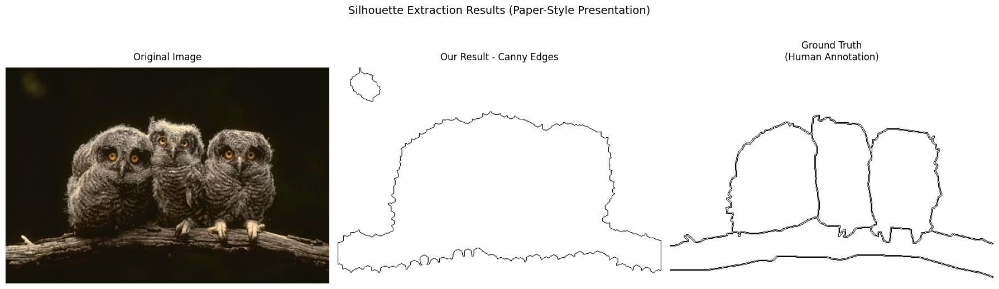

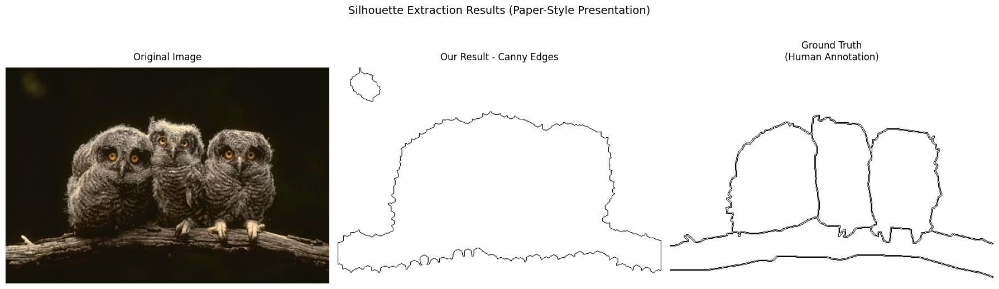

In [20]:
# Visualizar resultados en estilo paper (3 columnas)
from src.viz import plot_silhouette_comparison

mo.md(f"""
### Resultados: Extracción con Canny Edges

**Estadísticas de Extracción:**
- Contornos detectados: {sil_result_42044.contour_count}
- Foreground: {sil_result_42044.get_foreground_ratio()*100:.1f}% de la imagen
- Tiempo de procesamiento: {sil_result_42044.extraction_time*1000:.1f}ms
""")

fig_silhouette_42044 = plot_silhouette_comparison(
    original_image=image_42044,
    silhouette_image=sil_result_42044.silhouette_image,
    ground_truth_labels=ground_truth_42044,
    method_name="Canny Edges"
)

fig_silhouette_42044